# Text length analysis

In [8]:
import re
import string
import pandas as pd
import seaborn as sns
import matplotlib as mlp
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from matplotlib.patches import Patch
from matplotlib import rcParams
from matplotlib.spines import Spines
from matplotlib.patches import Rectangle


In [16]:
#rcParams default settings
"https://matplotlib.org/stable/tutorials/introductory/customizing.html"

#rcParams settings
plt.style.use('ggplot')

rcParams['font.family'] = 'sans-serif'
rcParams['font.style'] = 'normal'

rcParams['figure.facecolor'] = 'white'

rcParams['savefig.bbox'] = 'tight'
rcParams['savefig.dpi'] = 300
rcParams['savefig.transparent'] = True

rcParams['axes.spines.right'] = False
rcParams['axes.spines.top'] = False
rcParams['axes.labelsize'] = 20
rcParams['axes.labelcolor'] = 'black'
rcParams['axes.edgecolor'] = 'grey'
rcParams['axes.linewidth'] = 3
rcParams['axes.facecolor'] = 'white'
rcParams['axes.titlepad'] = 4
rcParams['axes.titlesize'] = 20
rcParams['axes.spines.right'] = True
rcParams['axes.spines.top'] = True

rcParams['xtick.color'] = 'grey'
rcParams['ytick.color'] = 'grey'
rcParams['xtick.labelsize'] = 15
rcParams['ytick.labelsize'] = 15
rcParams['xtick.major.width'] = 2
rcParams['ytick.major.width'] = 0
rcParams['xtick.major.size'] = 5
rcParams['ytick.major.size'] = 0

rcParams['lines.linewidth'] = 3
rcParams['lines.markersize'] = 10

rcParams['legend.title_fontsize'] = 15
rcParams['legend.fontsize'] = 10

rcParams['grid.color'] = 'grey'
rcParams['grid.linewidth'] = 0.1

icefire_palette = sns.color_palette("icefire")
sns.set_palette(icefire_palette)

# Functions

In [17]:
# Function to clean tweets
def preliminary_cleaning(t):              
    # Convert to lowercase
    text = t.lower()
        
    # Remove newlines, tabs, and extra whitespace
    text = text.replace('\n', ' ').replace('\t', ' ').replace('&amp;', '&').replace('&gt;', '')
    text = re.sub(r'\s+', ' ', text).strip()
    
    def remove_urls(text):
        # Define the regex pattern for URLs
        url_pattern = re.compile(r'https?://\S+|www\.\S+')
        # Use the sub method to replace URLs with an empty string
        cleaned_text = re.sub(url_pattern, '', text)
        return cleaned_text

    def remove_usernames(text):
        # Use a regular expression to find all @usernames at the beginning of the text
        cleaned_text = re.sub(r'^(@\w+\s*)+', '', text)
        return cleaned_text
    
    text = remove_urls(text)
    
    text = remove_usernames(text)
    
    return text

# Function to capitalize and replace specific usernames
def format_username(username):
    # Dictionary for specific replacements
    specific_replacements = {
        'lego_group': 'Lego Group',
        'hm': 'H&M',
        'detushepostdhl': 'DHL',
        'iberdrola_en': 'Iberdrola'
    }
    # Apply specific replacements if available
    if username in specific_replacements:
        return specific_replacements[username]
    # General case for handling 'group'
    if 'group' in username.lower():
        parts = username.split('group')
        return ' '.join([part.capitalize() for part in parts if part]) + ' Group'
    # Capitalize other usernames
    return username.capitalize()

In [18]:
df = pd.read_csv('cleaned_texts.csv', index_col=[0])
df.cleaned_text = df.cleaned_text.fillna(value='')
df.username = df.username.apply(lambda x: format_username(x))

# Wordclouds

In [19]:
from wordcloud import WordCloud

In [20]:
# Group by user
grouped = df.groupby('username')['cleaned_text'].apply(lambda x: ' '.join(x))

In [21]:
sorted_users = df.username.value_counts().index.to_list()

  0%|          | 0/40 [00:00<?, ?it/s]

C:\Users\valen\AppData\Local\Temp\ipykernel_30900\1609797286.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(20,10))


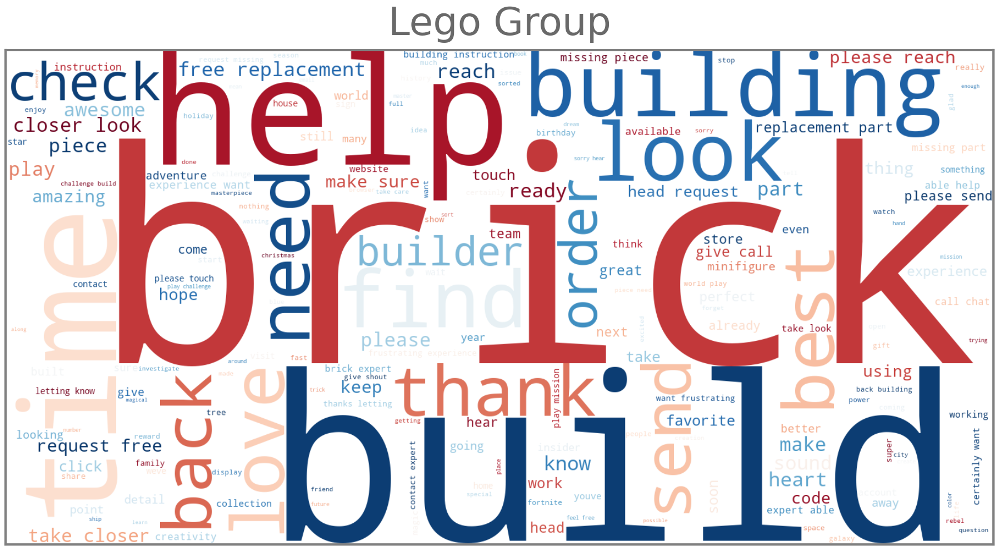

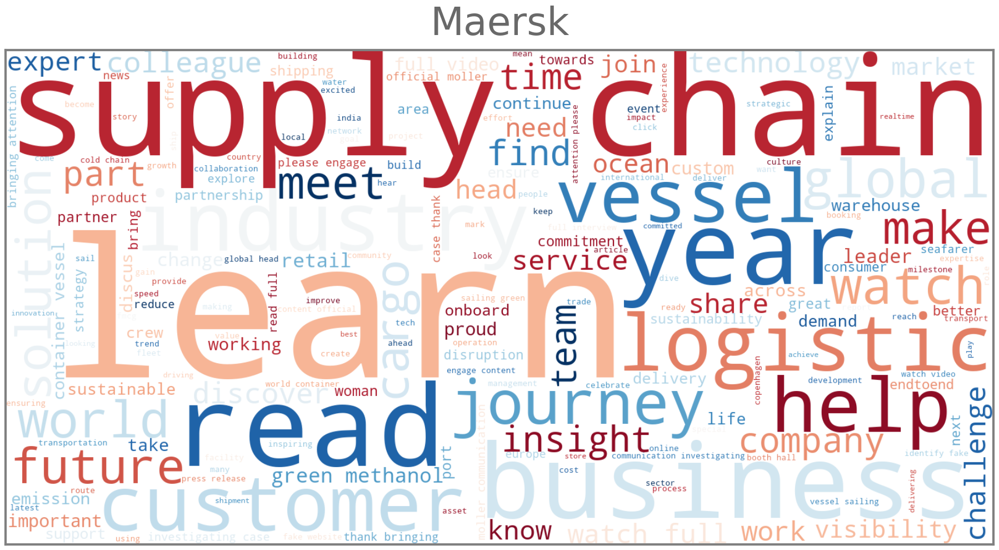

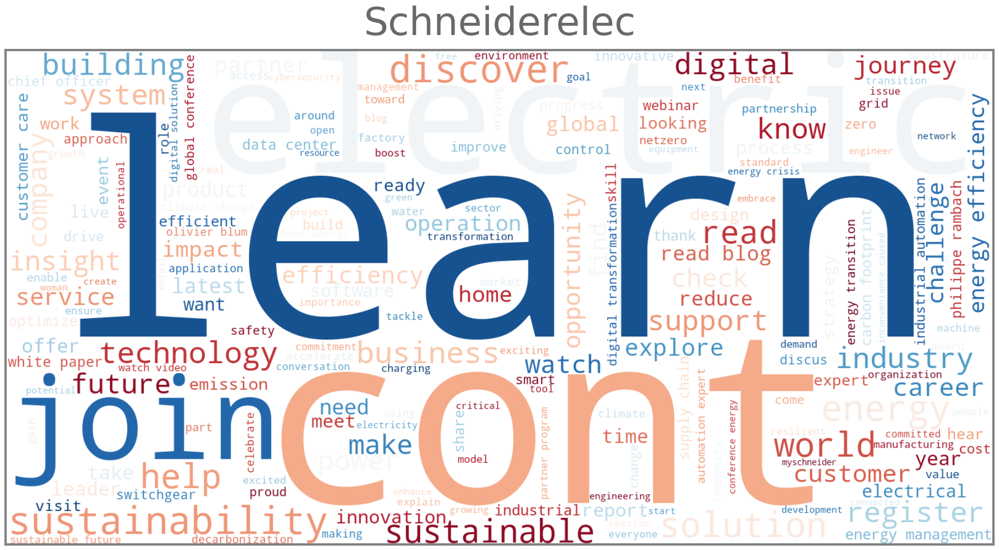

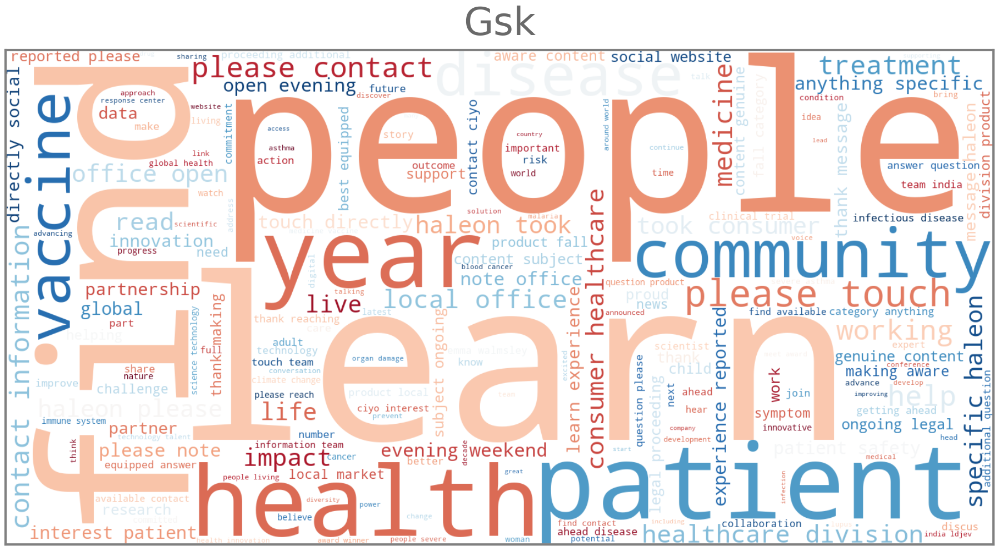

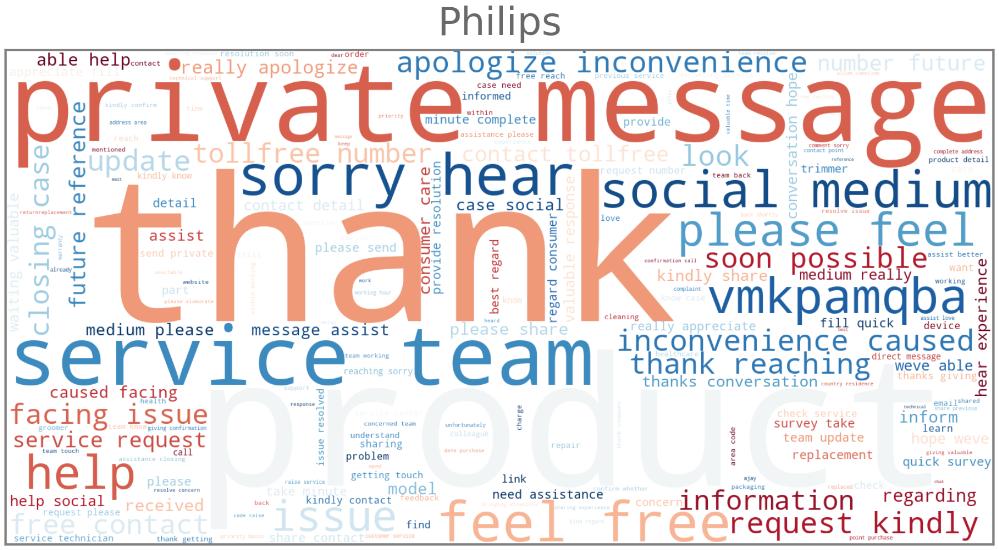

...

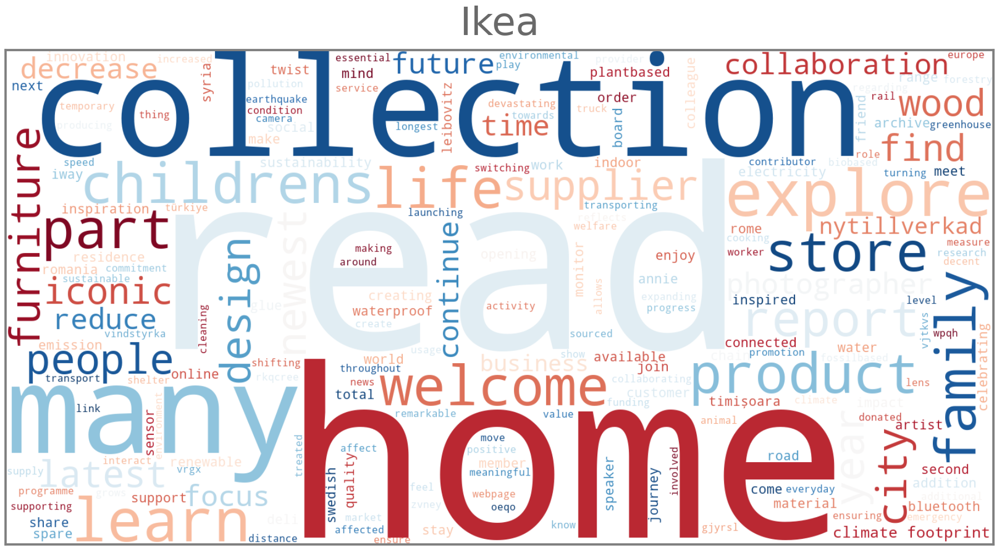

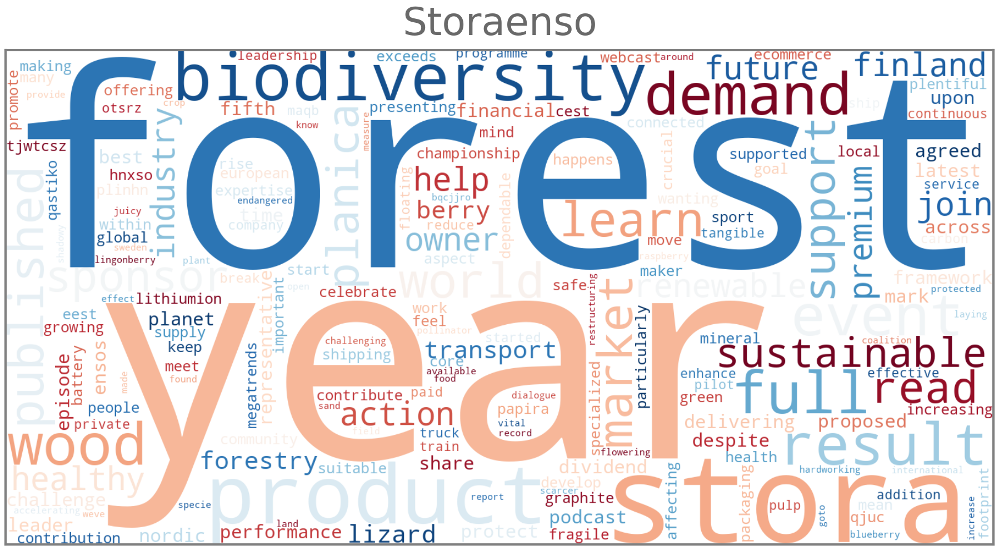

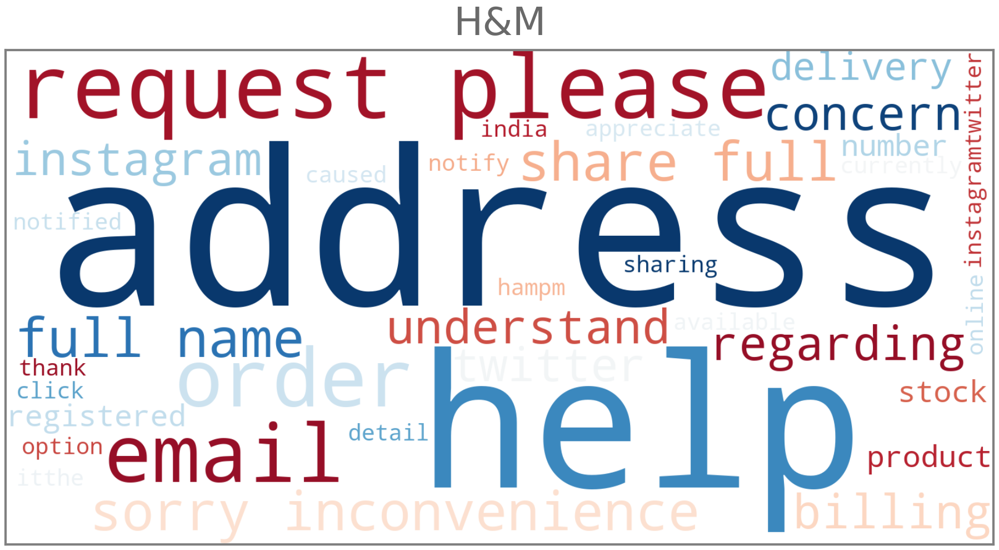

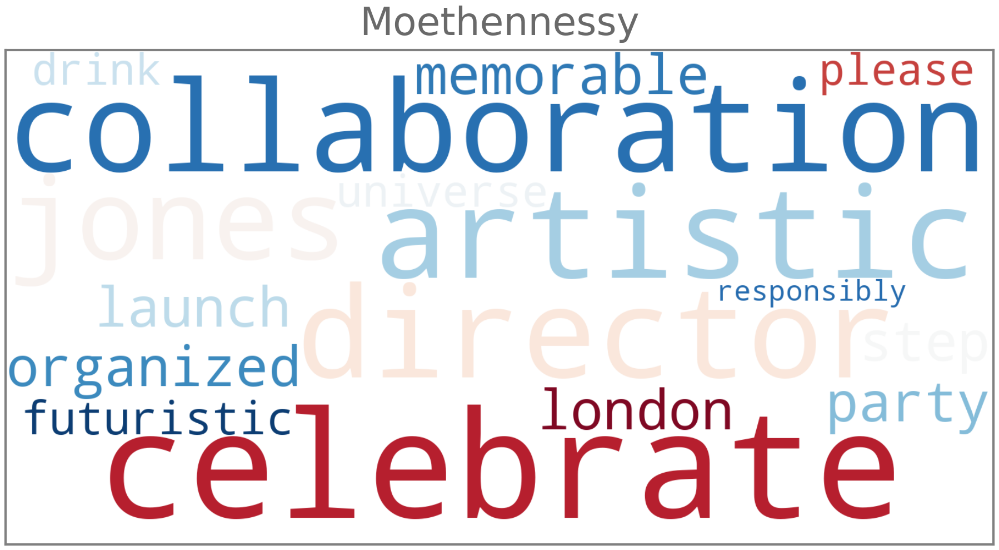

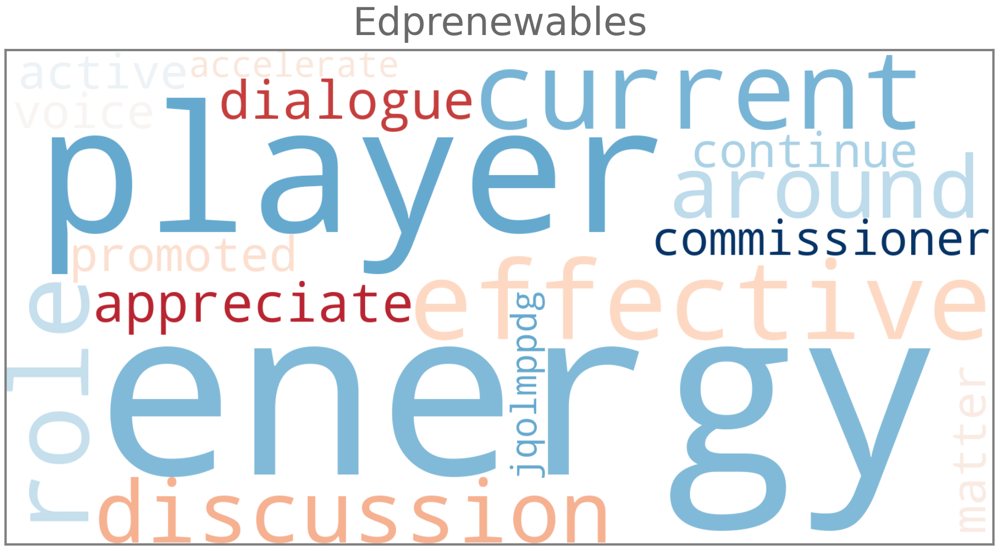

In [112]:
# Generate word clouds for each user
for i, user in tqdm(enumerate(sorted_users), total=len(sorted_users)):
    tweets = grouped[user]
    wordcloud = WordCloud(width=1600, height=800, background_color='white', colormap="RdBu").generate(tweets)
    
    fig, ax = plt.subplots(figsize=(20,10))
    plt.imshow(wordcloud, interpolation='bilinear')
    ax.set_title(f'{user}', fontsize=50, pad=20, color='dimgrey')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis("on")
    plt.tight_layout()    
    plt.savefig(f'../data/out/wordclouds/{i}_{user}_wordcloud.png', dpi=600, bbox_inches='tight')